In [106]:
import warnings
warnings.filterwarnings("ignore")
import os
from os.path import join
import pandas as pd
import numpy as np
import missingno as msno
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import KFold, cross_val_score
import xgboost as xgb
import lightgbm as lgb
import matplotlib.pyplot as plt
import seaborn as sns

In [107]:
file_path_son = 'datathon_energy/'
file_path_hea = '' 

train = pd.read_csv(file_path_son+'train.csv', encoding='cp949')  # 파일 path 바꿔가면서 쓰시면 될 거 같아요
test = pd.read_csv(file_path_son+'test.csv', encoding='cp949')

#train = pd.read_csv('~/_Python/Exploration/data/energy/train.csv', encoding = "cp949")
#test = pd.read_csv('~/_Python/Exploration/data/energy/test.csv', encoding = "cp949")
train.columns = ['num', 'date', 'use_electric', 'temperature', 'wind_speed', 'humidity', 'precipitation', 'sunshine', 'operation', 'solar_power']
train['date']= pd.to_datetime(train['date'])


In [108]:
corr_df= train[['use_electric', 'date', 'temperature', 'wind_speed', 'humidity', 'precipitation', 'sunshine', 'operation', 'solar_power']]

In [109]:
train.head()

,num,date,use_electric,temperature,wind_speed,humidity,precipitation,sunshine,operation,solar_power
0,1,2020-06-01 00:00:00,8179.056,17.6,2.5,92.0,0.8,0.0,0.0,0.0
1,1,2020-06-01 01:00:00,8135.640,17.7,2.9,91.0,0.3,0.0,0.0,0.0
2,1,2020-06-01 02:00:00,8107.128,17.5,3.2,91.0,0.0,0.0,0.0,0.0
3,1,2020-06-01 03:00:00,8048.808,17.1,3.2,91.0,0.0,0.0,0.0,0.0
4,1,2020-06-01 04:00:00,8043.624,17.0,3.3,92.0,0.0,0.0,0.0,0.0


In [110]:
# 시간 변수

date = train['date']
train['hour'] = date.dt.hour
train['day'] = date.dt.weekday
train['month'] = date.dt.month
train['week'] = date.dt.weekofyear # 1년 중 몇번째 주
train['dayofyear'] = date.dt.dayofyear  # 1년 중 몇번째 날

# 공휴일 변수 추가

train['holiday'] = train.apply(lambda x : 0 if x['day']<5 else 1, axis = 1)
train['holiday'] = train.loc[('2020-08-17'<=train['date'])&(train['date']<'2020-08-18'), 'holiday'] = 1

# 시간을 sin, cos 함수로

train['sin_time'] = np.sin(2*np.pi*train.hour/24)
train['cos_time'] = np.cos(2*np.pi*train.hour/24)

# THI(temperature-humidity index) : 불쾌지수

train['THI'] = 9/5*train['temperature'] - 0.55*(1-train['humidity']/100)*(9/5*train['humidity']-26)+32

# CDH(Cooling Degree Hour) : 냉방 도일

def CDH(xs):
    ys = []
    for i in range(len(xs)):
        if i < 11:
            ys.append(np.sum(xs[:(i+1)]-26))
        else:
            ys.append(np.sum(xs[(i-11):(i+1)]-26))
    return np.array(ys)

cdhs = np.array([])
for num in range(1,61,1):
    temp = train[train['num'] == num]
    cdh = CDH(temp['temperature'].values)
    cdhs = np.concatenate([cdhs, cdh])
train['CDH'] = cdhs

# 체감 온도

train['body_temperature'] = 13.12 + 0.6215*train['temperature'] - 11.37*(train['wind_speed']*3.6)**0.16 + 0.3965*(train['wind_speed']*3.6)**0.16*train['temperature']

# 화씨로 변형

train['temperature_F'] = (train['temperature'] * 9/5) + 32 

# 열지수

T = train['temperature_F']
RH = train['humidity']
train['heat_index'] = -42.379 + 2.04901523*T + 10.14333127*RH - .22475541*T*RH - .00683783*T*T - .05481717*RH*RH + .00122874*T*T*RH + .00085282*T*RH*RH - .00000199*T*T*RH*RH
train['heat_index'] = (train['heat_index']-32) * 5/9
train.loc[train['heat_index']<32, 'heat_index'] = 0
train.loc[(train['heat_index']>=32) & (train['heat_index']<41), 'heat_index'] = 1
train.loc[(train['heat_index']>=41) & (train['heat_index']<54), 'heat_index'] = 2
train.loc[(train['heat_index']>=54) & (train['heat_index']<66), 'heat_index'] = 3
train.loc[train['heat_index']>=66, 'heat_index'] = 4

# echo_type
train['month_day'] = train['date'].astype(str).str[:10] ## 2020-06-01
train['echo_type'] = train['operation'] + train['solar_power']*2 ##  0: 아무것도 없음 1: operation만 2:solar_system만 3: operation과 solar_system 둘다


In [138]:
train[(train['holiday']==1) & (train['date']>= '2020-08-17') & (train['date'] < '2020-08-18')]

,num,date,use_electric,temperature,wind_speed,humidity,precipitation,sunshine,operation,solar_power,...,holiday,sin_time,cos_time,THI,CDH,body_temperature,temperature_F,heat_index,month_day,echo_type
1848,1,2020-08-17 00:00:00,8656.632,26.8,2.5,87.0,0.0,0.0,0.0,0.0,...,1,0.000000,1.000000,70.9021,31.3,28.719054,80.24,0.0,2020-08-17,0.0
1849,1,2020-08-17 01:00:00,8624.880,26.6,2.8,86.0,0.0,0.0,0.0,0.0,...,1,0.258819,0.965926,69.9624,27.8,28.460641,79.88,0.0,2020-08-17,0.0
1850,1,2020-08-17 02:00:00,8626.176,26.5,3.0,87.0,0.0,0.0,0.0,0.0,...,1,0.500000,0.866025,70.3621,23.8,28.327246,79.70,0.0,2020-08-17,0.0
1851,1,2020-08-17 03:00:00,8626.176,26.4,2.3,88.0,0.0,0.0,0.0,0.0,...,1,0.707107,0.707107,70.7816,19.6,28.262037,79.52,0.0,2020-08-17,0.0
1852,1,2020-08-17 04:00:00,8617.752,26.3,1.7,88.0,0.0,0.0,0.0,0.0,...,1,0.866025,0.500000,70.6016,15.6,28.206657,79.34,0.0,2020-08-17,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122227,60,2020-08-17 19:00:00,4261.248,28.0,1.2,81.0,0.0,0.9,1.0,1.0,...,1,-0.965926,0.258819,69.8809,25.2,30.183302,82.40,1.0,2020-08-17,3.0
122228,60,2020-08-17 20:00:00,4202.064,26.8,2.1,86.0,0.0,0.0,1.0,1.0,...,1,-0.866025,0.500000,70.3224,26.5,28.748137,80.24,0.0,2020-08-17,3.0
122229,60,2020-08-17 21:00:00,4036.608,26.0,2.1,92.0,0.0,0.0,1.0,1.0,...,1,-0.707107,0.707107,72.6576,26.3,27.812511,78.80,0.0,2020-08-17,3.0
122230,60,2020-08-17 22:00:00,3850.416,25.8,1.0,87.0,0.0,0.0,1.0,1.0,...,1,-0.500000,0.866025,69.1021,25.6,27.755024,78.44,0.0,2020-08-17,3.0


In [111]:
# 3차원 그래프 함수(hue포함)

def draw3D(df, x, y, z, coloraxis = None):
    import plotly.graph_objs as go
    import numpy as np

    # Create some random data
    n = 100
    # Define the color map
    #colorscale = [[0, 'blue'], [1./3, 'green'], [2./3, 'red'], [1, 'blue']]
    colorscale = ['#000000', '#6b0707', '#ec8109', '#ecc509', '#76ec09', '#09a8ec']

    if (coloraxis == None):
        coloraxis = z
    # Create the scatter plot with z-axis colored
    fig = go.Figure(data=[go.Scatter3d(
        x=df[x],
        y=df[y],
        z=df[z],
        mode='markers',
        marker=dict(
            size=2,
            color=df[coloraxis],
            colorscale=colorscale,
            opacity=0.8,
            colorbar=dict(
                title='Z Axis Colorbar Title'
            )
        ),
        hovertemplate='x: %{x}<br>y: %{y}<br>z: %{z}<br>color: %{marker.color}<extra></extra>'
    )])

    # Add axis labels
    fig.update_layout(width=1000, height=800, scene=dict(xaxis_title=x, yaxis_title=y, zaxis_title=z))

    # Show the plot
    fig.show()

In [112]:
#표준편차 구하기

df_std=train['use_electric'].groupby([train['num'], train['month_day'],train['echo_type']]).std()
df_std=df_std.reset_index()
df_std['ele_std']=df_std['use_electric']
df_std.drop('use_electric', axis =1 ,inplace=True)
_type =[3,32,18,39]
display = df_std[df_std['num'].isin(_type)==True]
#draw3D(display,'num','month_day','ele_std','echo_type')

In [113]:
#1. -자형데이타
_type =[1,9,18,19,21,31,32,33,36,39]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

In [114]:
#2. -자형 산발 데이타 
_type =[3,28,34,35,39,40,49,50,51,58,59,60]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')


In [115]:
# =자형  데이타 
_type =[2,6,7,10,13,16,18,22,25,26,27,37,41,45,46,47,48,52,53,56]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

In [116]:
# =자형 산발 데이타 
_type =[8,14,15,23,24,38,29,54,55,57]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

In [117]:
# 산발 데이타 
_type =[4,5,11,12,20,42,43,44]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

In [118]:
train.head()

,num,date,use_electric,temperature,wind_speed,humidity,precipitation,sunshine,operation,solar_power,...,holiday,sin_time,cos_time,THI,CDH,body_temperature,temperature_F,heat_index,month_day,echo_type
0,1,2020-06-01 00:00:00,8179.056,17.6,2.5,92.0,0.8,0.0,0.0,0.0,...,1,0.000000,1.000000,57.5376,-8.4,17.816719,63.68,0.0,2020-06-01,0.0
1,1,2020-06-01 01:00:00,8135.640,17.7,2.9,91.0,0.3,0.0,0.0,0.0,...,1,0.258819,0.965926,57.0389,-16.7,17.786580,63.86,0.0,2020-06-01,0.0
2,1,2020-06-01 02:00:00,8107.128,17.5,3.2,91.0,0.0,0.0,0.0,0.0,...,1,0.500000,0.866025,56.6789,-25.2,17.444480,63.50,0.0,2020-06-01,0.0
3,1,2020-06-01 03:00:00,8048.808,17.1,3.2,91.0,0.0,0.0,0.0,0.0,...,1,0.707107,0.707107,55.9589,-34.1,16.961384,62.78,0.0,2020-06-01,0.0
4,1,2020-06-01 04:00:00,8043.624,17.0,3.3,92.0,0.0,0.0,0.0,0.0,...,1,0.866025,0.500000,56.4576,-43.1,16.806826,62.60,0.0,2020-06-01,0.0


In [119]:
temp=train

In [120]:
train_dic={}
for i in range(1,61): 
    train_dic[i] = temp[temp['num'] == int('%s'%(i))]
    train_dic[i]['use_electric']=(train_dic[i]['use_electric']-train_dic[i]['use_electric'].mean())/train_dic[i]['use_electric'].std()

In [124]:
def graph_5(train_dic,_type):
    fig,axe = plt.subplots(5,1,figsize=[24,36],tight_layout=True)
    for i,x in enumerate(_type):
        sns.lineplot(data = train_dic[x],x='date',y='use_electric',ax=axe[i])

### 1자형

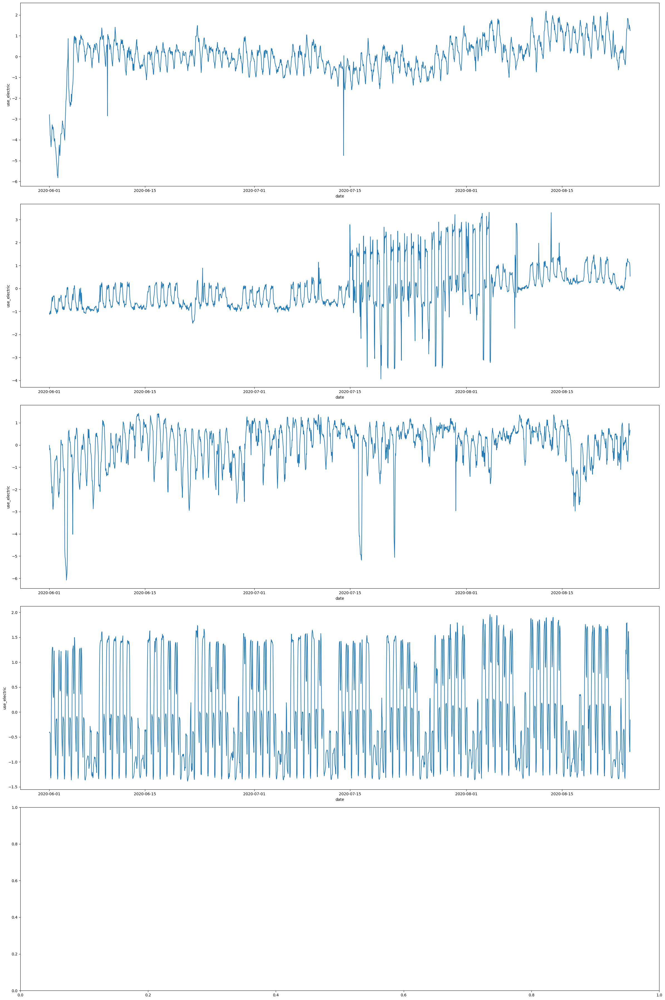

In [155]:
#1자
_type = [1,3,9,18]
graph_5(train_dic,_type)

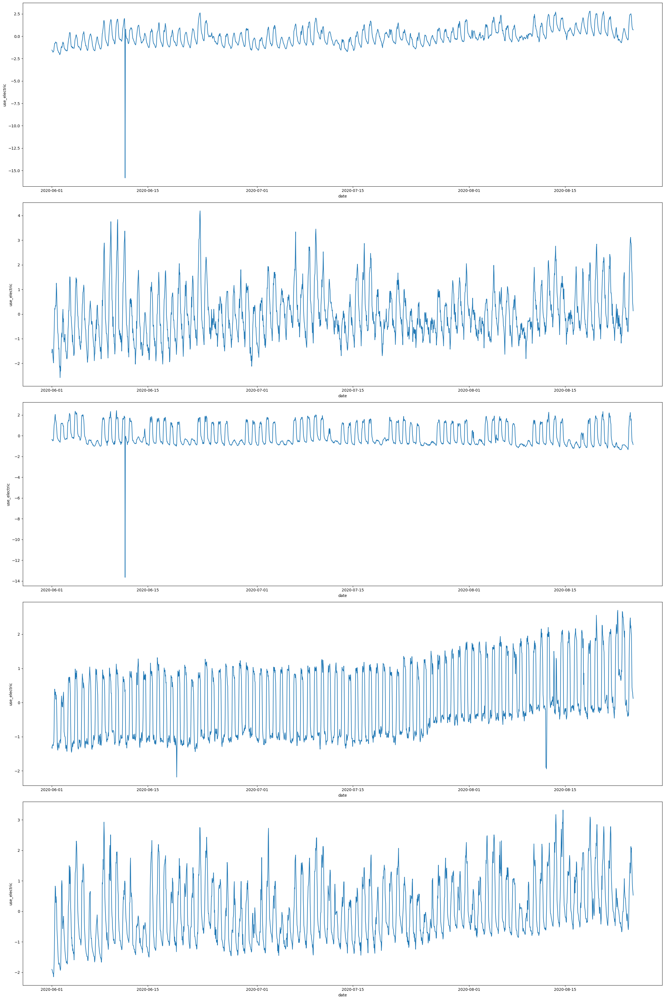

In [126]:
# 1자
_type = [31,32,33,36,39]
graph_5(train_dic,_type)

### 1자형 산발

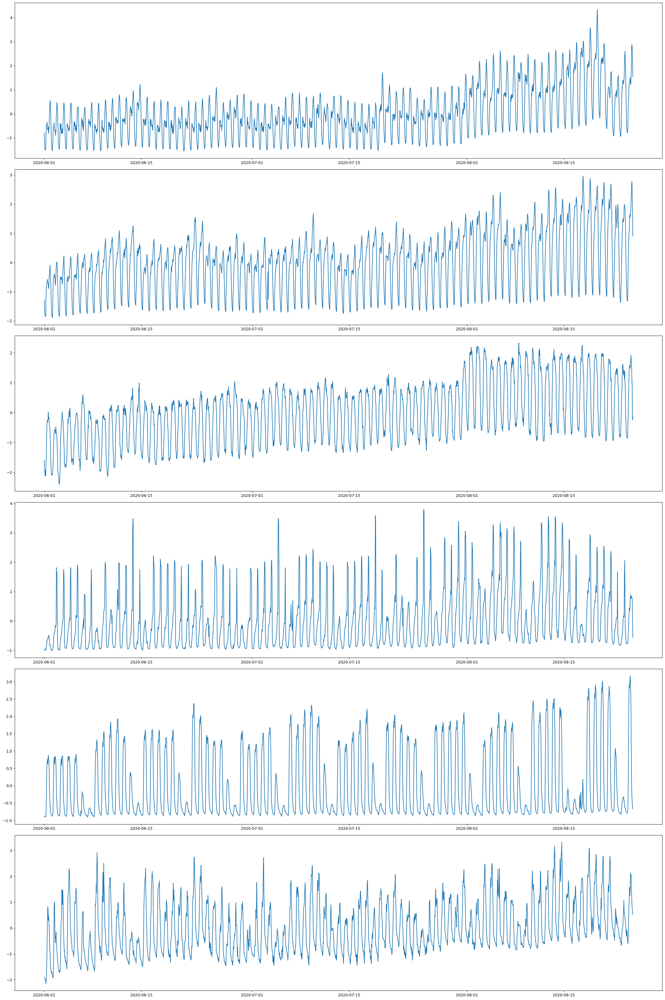

In [154]:
_type =[19,21,28,34,35,39]
fig,axe = plt.subplots(6,1,figsize=[24,36],tight_layout=True)
for i,x in enumerate(_type):
    axe[i].plot(train_dic[x]['date'],train_dic[x]['use_electric'])

<AxesSubplot: xlabel='date', ylabel='use_electric'>

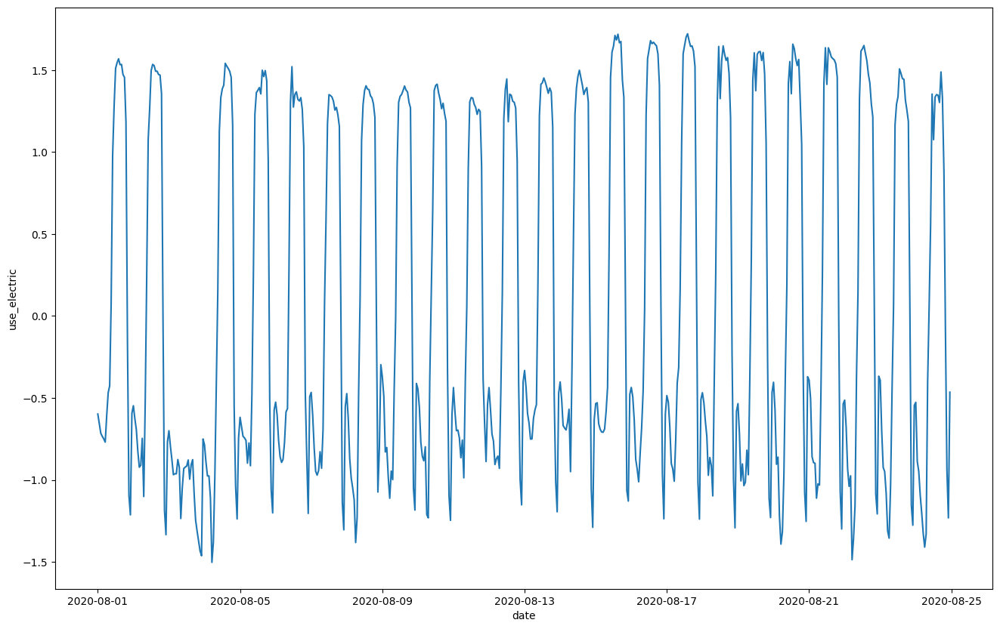

In [142]:
# 40번 8월

fig = plt.figure(figsize=[16,10])
date_8=train_dic[40][train_dic[40]['date']>='2020-08-01']

sns.lineplot(x=date_8['date'],y=date_8['use_electric'])

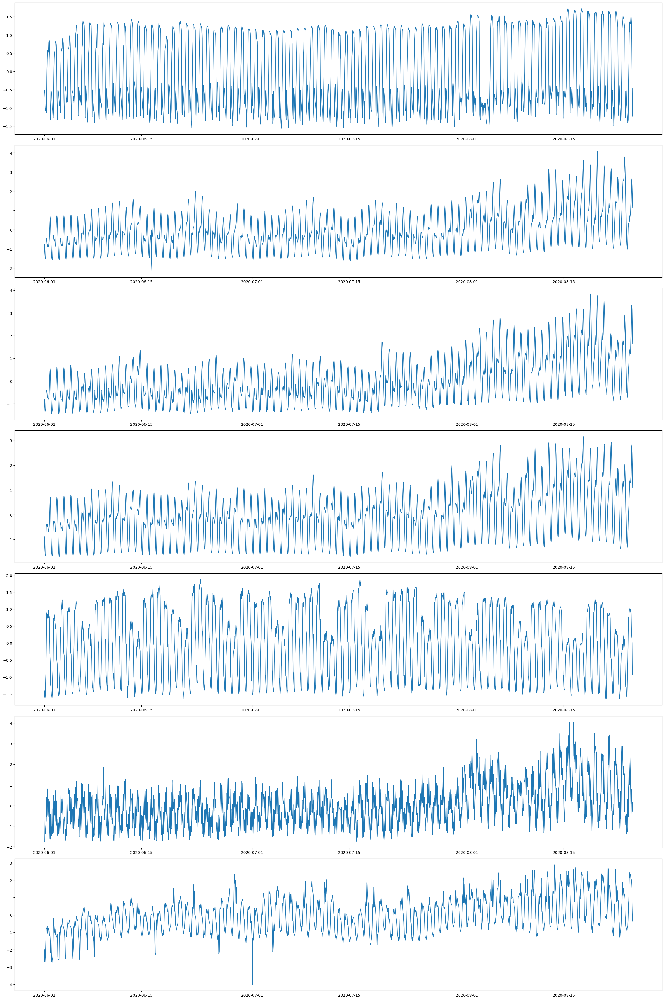

In [153]:
_type=[40,49,50,51,58,59,60]
fig,axe = plt.subplots(7,1,figsize=[24,36],tight_layout=True)
for i,x in enumerate(_type):
    axe[i].plot(train_dic[x]['date'],train_dic[x]['use_electric'])

<AxesSubplot: xlabel='date', ylabel='use_electric'>

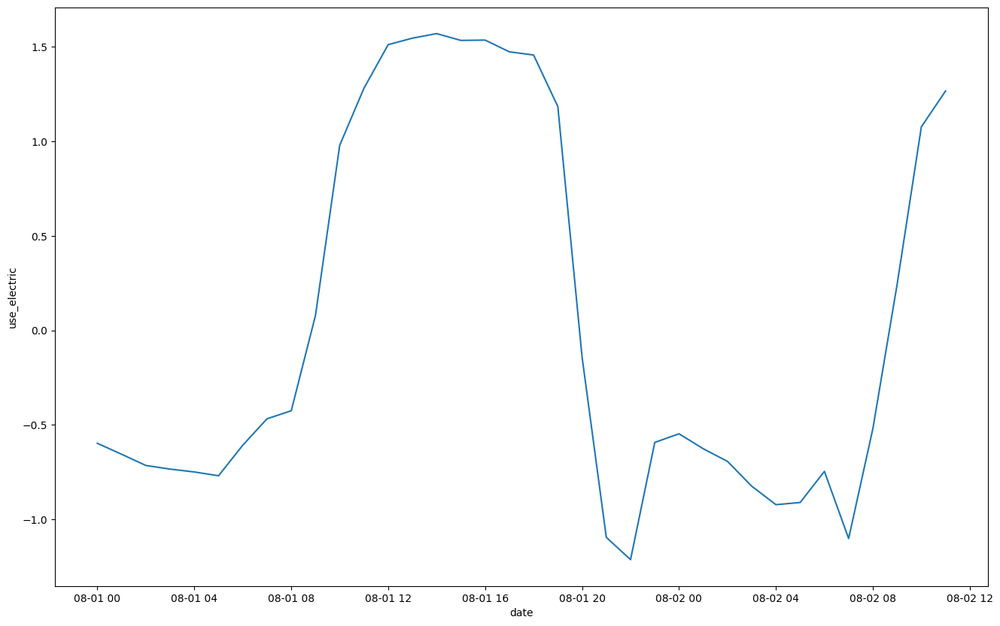

In [149]:
# 40번 8월 1일 - 2일

fig = plt.figure(figsize=[16,10])
date_8_1_2=train_dic[40][(train_dic[40]['date']>='2020-08-01')&(train_dic[40]['date']<'2020-08-02 12:00')]

sns.lineplot(x=date_8_1_2['date'],y=date_8_1_2['use_electric'])

<AxesSubplot: xlabel='date', ylabel='use_electric'>

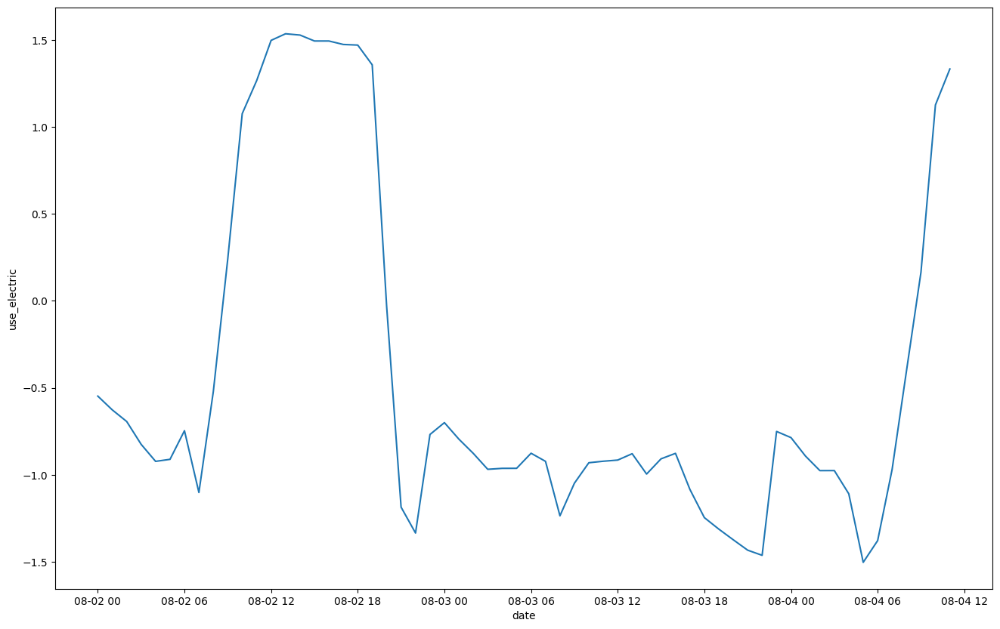

In [151]:
# 40번 8월 2일 - 4일

fig = plt.figure(figsize=[16,10])
date_8_2_4=train_dic[40][(train_dic[40]['date']>='2020-08-02') & (train_dic[40]['date']<'2020-08-04 12:00')]

sns.lineplot(x=date_8_2_4['date'],y=date_8_2_4['use_electric'])

### 2자형

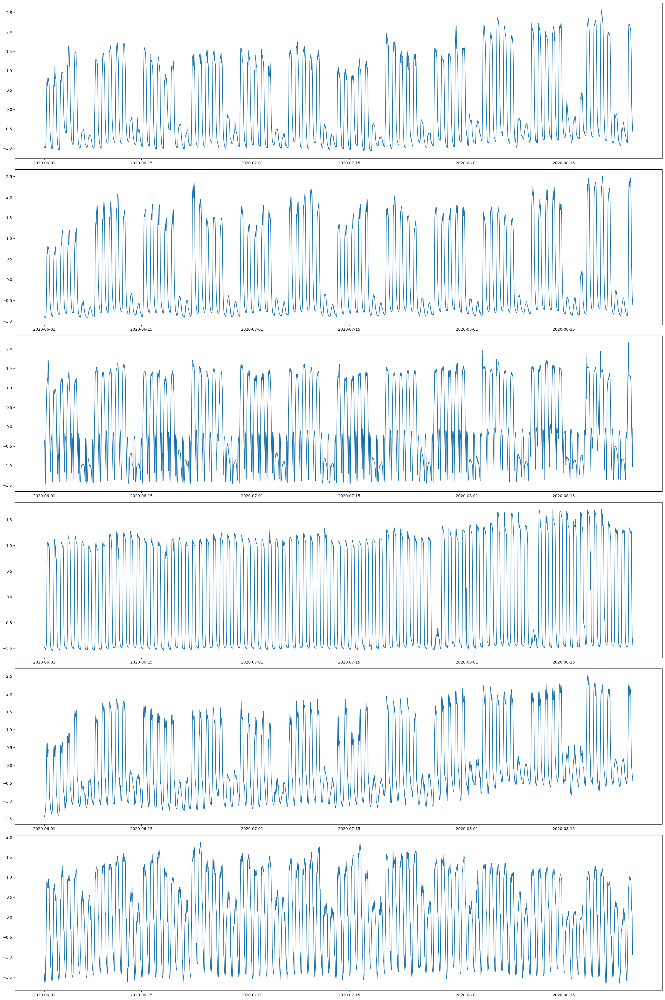

In [162]:
# =자형  데이타 
_type =[2,6,7,10,13,58]
fig,axe = plt.subplots(6,1,figsize=[24,36],tight_layout=True)
for i,x in enumerate(_type):
    axe[i].plot(train_dic[x]['date'],train_dic[x]['use_electric'])

<AxesSubplot: xlabel='date', ylabel='use_electric'>

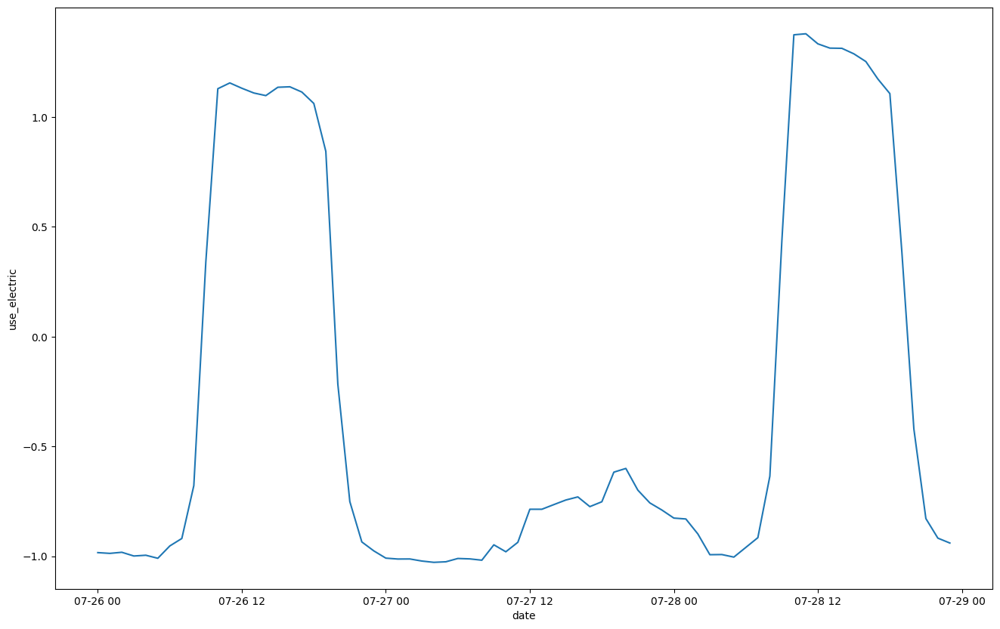

In [169]:
# 10번 7월 20일 - 7월 31일

fig = plt.figure(figsize=[16,10])
date_7=train_dic[10][(train_dic[10]['date']>='2020-07-26')&(train_dic[10]['date']<'2020-07-29')]

sns.lineplot(x=date_7['date'],y=date_7['use_electric'])

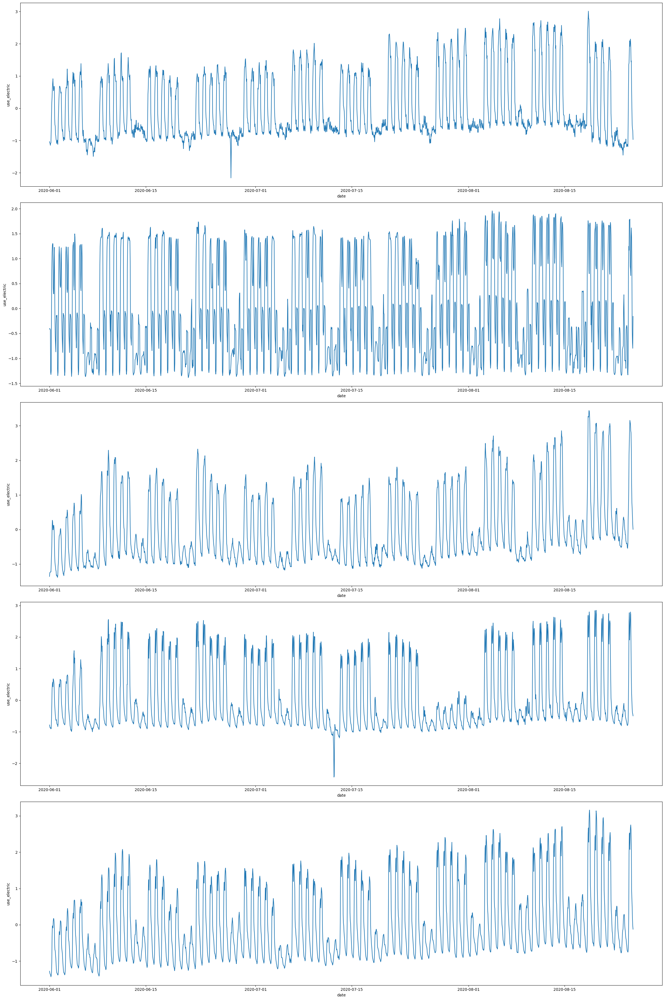

In [130]:
_type =[16,18,22,25,26]
graph_5(train_dic,_type)

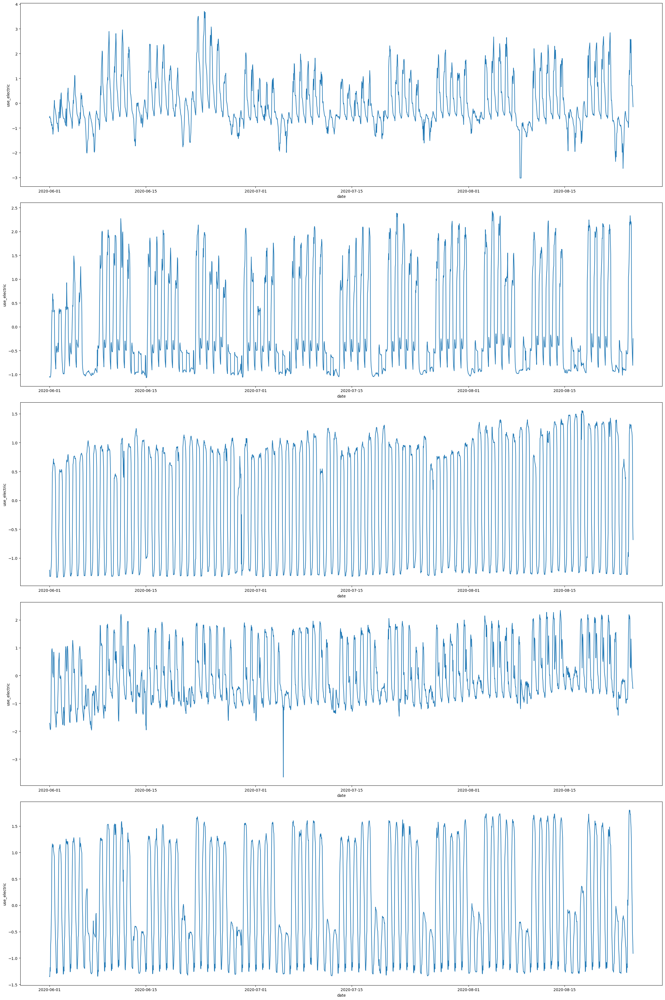

In [131]:
_type =[27,37,41,45,46]
graph_5(train_dic,_type)

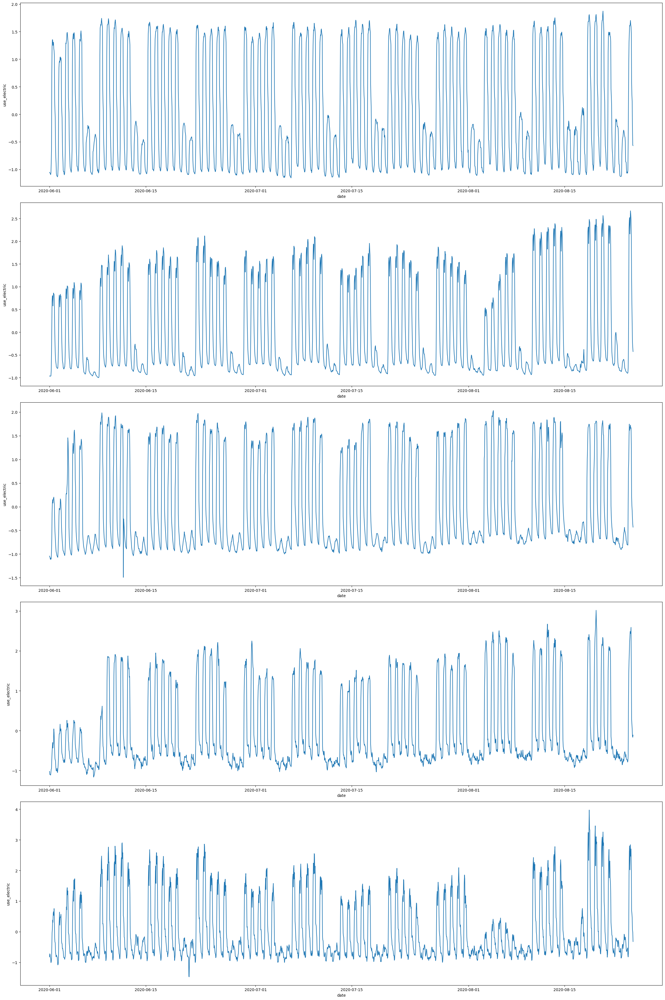

In [132]:
_type =[47,48,52,53,56]
graph_5(train_dic,_type)

### 2자형 산발 데이터

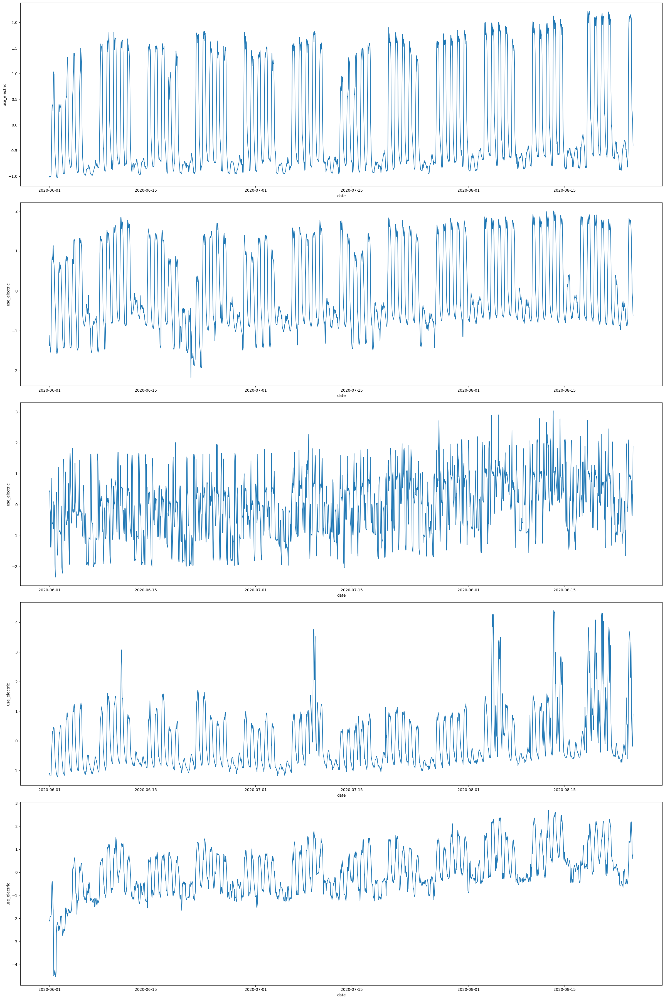

In [133]:
# =자형 산발 데이타 
_type =[8,14,15,23,24]
graph_5(train_dic,_type)

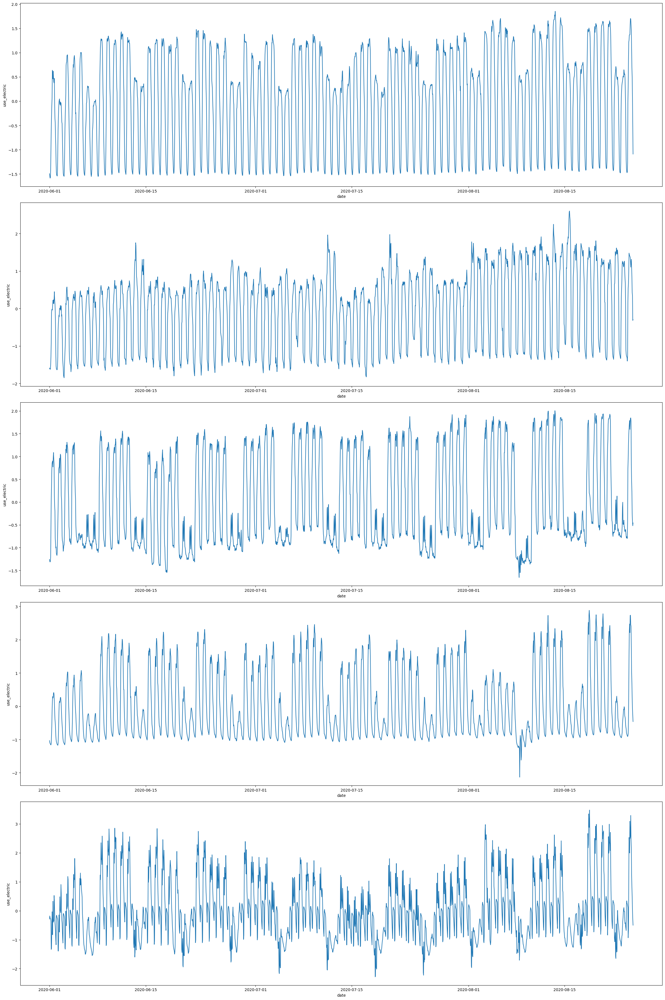

In [134]:
_type = [38,29,54,55,57]
graph_5(train_dic,_type)

### 산발 데이터

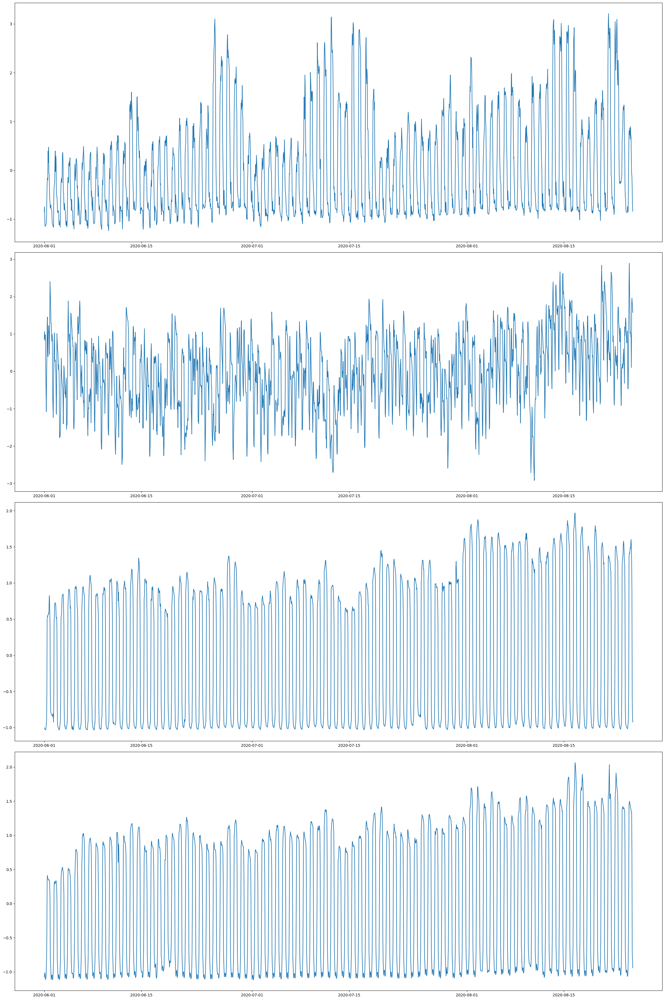

In [135]:
# 산발 데이타 
_type =[4,5,11,12]
fig,axe = plt.subplots(4,1,figsize=[24,36],tight_layout=True)
for i,x in enumerate(_type):
    axe[i].plot(train_dic[x]['date'],train_dic[x]['use_electric'])

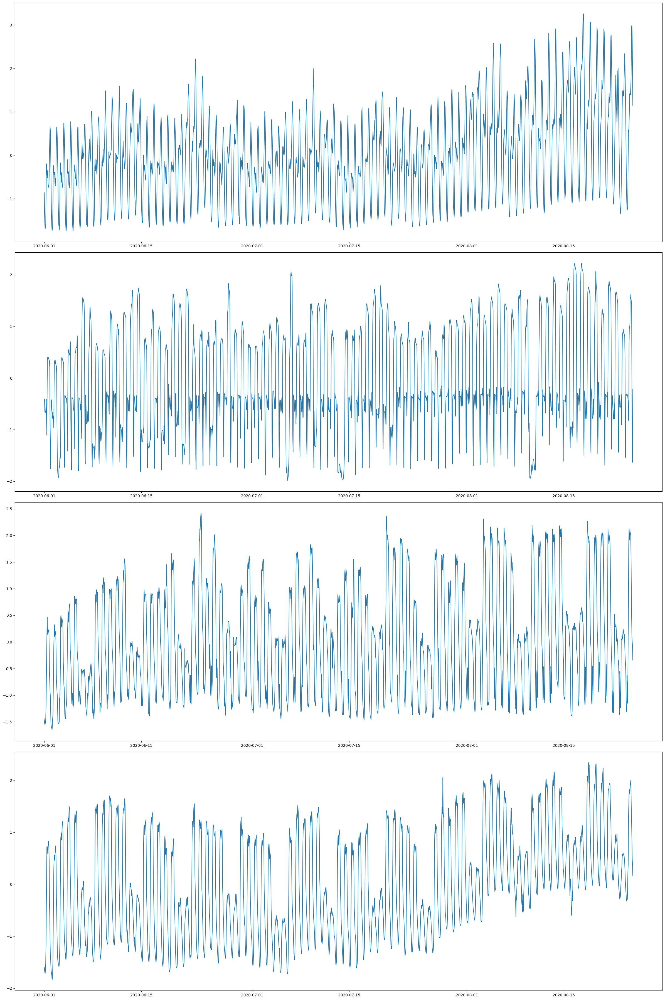

In [136]:
_type = [20,42,43,44]
fig,axe = plt.subplots(4,1,figsize=[24,36],tight_layout=True)
for i,x in enumerate(_type):
    axe[i].plot(train_dic[x]['date'],train_dic[x]['use_electric'])

<AxesSubplot: xlabel='date', ylabel='use_electric'>

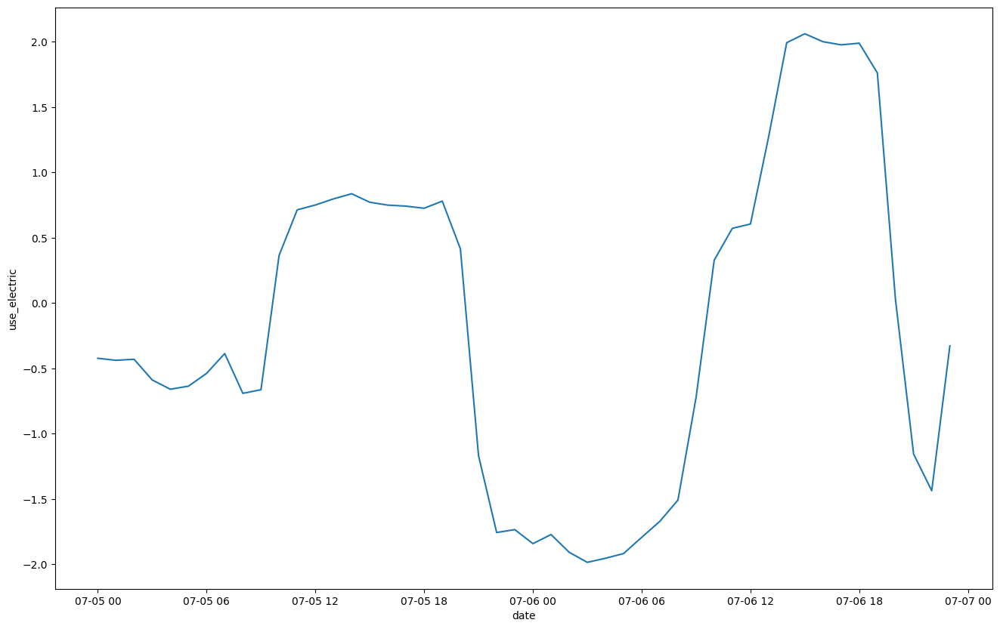

In [176]:
# 42번  사무실 일듯.

fig = plt.figure(figsize=[16,10])
date_7=train_dic[42][(train_dic[42]['date']>='2020-07-05')&(train_dic[42]['date']<'2020-07-07')]

sns.lineplot(x=date_7['date'],y=date_7['use_electric'])

<AxesSubplot: xlabel='date', ylabel='use_electric'>

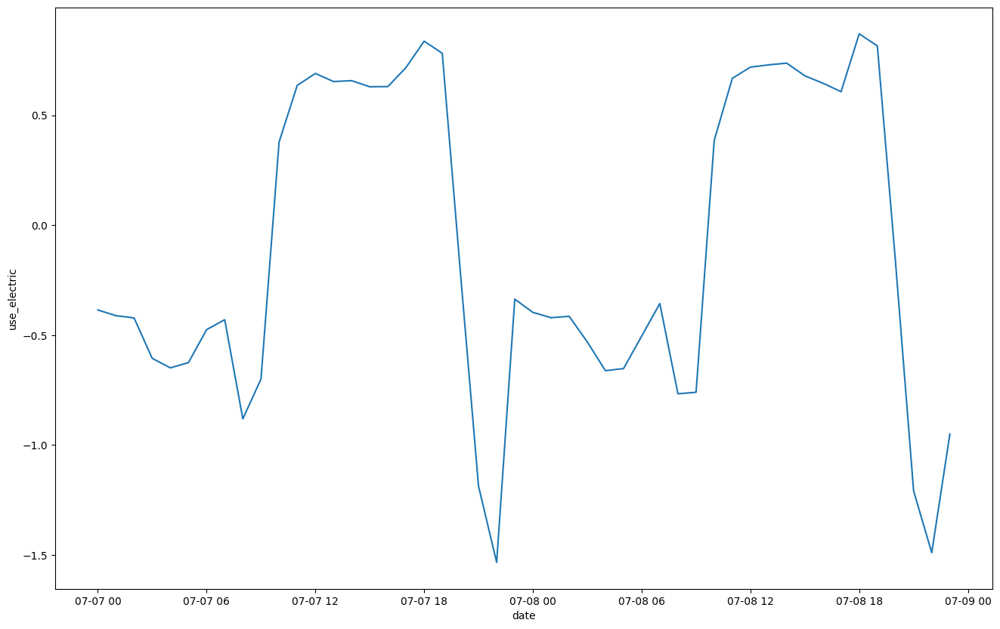

In [177]:
# 42번

fig = plt.figure(figsize=[16,10])
date_7=train_dic[42][(train_dic[42]['date']>='2020-07-07')&(train_dic[42]['date']<'2020-07-09')]

sns.lineplot(x=date_7['date'],y=date_7['use_electric'])